<a href="https://colab.research.google.com/github/Yuvraj-Dhepe/uni_ml/blob/main/dida_task/Colab_Final_Version_of_Dida_task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Brief About the Rooftop segmentation Task

- **On some runs, of this notebook I got poor segmentations by NN's on both normal and augmented images, maybe it depended on the Colab's GPU n Ram performance. So re-running a notebook is a good choice if you see a very poor segmentation in some run**
- **You can directly go to [Observations sections](#Observations-Section) (Link works in local jupyter notebook) to look how my final submission plots look like**

Dear team,
Thank you for allowing me to work on this task. It was pretty engaging and I got to try different aspects on how to handle a deep learning architecture with less data, and extract the best out of an algorithm. Before we get into codes, I thought to explain a bit of work I did, and how it's divided into the following sections. I have explained these sections in a bit more detail where I felt the explanation is necessary, you can find it at the beginning of each section. Also I have placed appropriate comments at various places in code to make the understanding effortless.

**If you have any questions feel free to reachout on my [email](mailto:yuvi.kiit@gmail.com)**

P.S.: **Execute collapsed sections is the best way to run the whole notebook in just 6 clicks and following hyperlinks to jump to respective sections**

I divided the notebook into 5 sections:
- [Importing and Installing the required Libraries Section](#Importing-and-Installing-the-required-Libraries-Section):
    - Section consisting of all important library imports required to execute this notebook
    
- [Utility Functions & Variables Section](#Utility-Functions-&-Variables-Section):
    - Includes function definitions (except network architecture defining functions) used for notebook code execution 
    
- [Loading, Augmenting and Visualizing Images Section](#Loading,-Augmenting-and-Visualizing-Images-Section):
    - Uses the utility preprocessing functions to load images, from respective folders
    
- [Model Training Section](#Model-Training-Section):
    - This section includes model architecture defining functions, training these models, calculating metrics of tpr, fpr, on validation sets.

- [Observations Section](#Observations-Section):
    - In this section comprehensive comparision between models is done on base of their training, validation accuracy and loss plots, ROC Curve and evaluate them on metrics of precision, recall and f1 score

- [Best Models Section](#Best-Models-Section):
    - This section simply includes training of best models on whole training data both normal and augmented. After training visual prediction plots are generated with optimal threshold values obtained during model predictions on validation sets.

- [References and Conculsions Section](#References-and-Conclusions-Section): 
    - Includes references I went through during this segmentation tasks, and conclusions I made from this whole task

## Loading G-Drive

In [1]:
# from google.colab import drive
# drive.mount('/content/gdrive', force_remount=True)

## Importing and Installing the required Libraries Section
- [Link To Brief](#Brief-About-the-Rooftop-segmentation-Task)
- [Link To Utility Functions & Variables Section](#Utility-Functions-&-Variables-Section)

In [ ]:
!pip install albumentations
!pip install ipympl
!pip install numpy==1.23
!apt remove git -y
!apt-get update -y
!apt-get install git -y && git clone https://github.com/tensorflow/examples.git

%cd /kaggle/working/examples 
#Necessary to import tensorflow examples

In [3]:
import os
import cv2
import keras

import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
import tensorflow as tf
import albumentations as A
import matplotlib.pyplot as plt

from skimage.transform import resize
from sklearn.model_selection import KFold

from sklearn.metrics import accuracy_score
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import confusion_matrix
from scipy.spatial.distance import euclidean
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import LeakyReLU
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split


from keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import vgg16, MobileNetV2
from tensorflow_examples.models.pix2pix import pix2pix
from tensorflow.keras.wrappers.scikit_learn import KerasRegressor
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization,GlobalMaxPooling2D,\
 GlobalAveragePooling2D, Conv2DTranspose, ZeroPadding2D, concatenate, Input, Activation, Dropout

#import ipympl
# Enables Use of Ipympl to zoom in and out of the plots
# from google.colab import output
# output.enable_custom_widget_manager()
# from google.colab import output
# output.disable_custom_widget_manager()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Utility Functions & Variables Section
- [Link To Importing and Installing the required Libraries Section](#Importing-and-Installing-the-required-Libraries-Section)

- Includes function definitions (except network architecture defining functions) used for notebook code execution 
    - [Preprocessing Functions](#Preprocessing-Functions): Functions to preprocess and augment images
    - [Metric Functions](#Metric-Functions): Functions to generate ROC metrics, Cross Validation, F1, Recall and Precision scores
    - [Visualization Functions](#Visualization-Functions): Functions to create a viz for ROC, Accuracy and Loss plots
    - [Model Info Functions](#Model-Info-Function): Generates model architecture's dataframe and a diagramatic png representation

- [Link To Loading, Augmenting and Visualizing Images Section](#Loading,-Augmenting-and-Visualizing-Images-Section)

In [4]:
### Global Variables
model_histories = {} # {model_name: training_history}
models = {} # {model_name:[model,tprs,fprs]} Used for simultaneous predictions and plotting roc curves.

### Preprocessing Functions

#### Image Loading and Preprocessing Functions

In [5]:
def train_test_img_loader(path:str, size:int)-> np.array:
    '''
    Load images from folders
    @param: path: directory path
    @param: size: new size for images
    '''
    # Getting Names of images
    image_files = sorted(os.listdir(path)) 
    # Blank array to store images
    images = []
    # Iterating through every image location, reading it and storing it in an array
    for file in image_files:
        image_path = os.path.join(path, file)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        resized_image = resize(image, (size,size))
        images.append(resized_image)
    return np.array(images)

def label_img_loader(path:str, size:int)-> np.array:
    '''
    Load labels from folders
    @param: path: directory path
    @param: size: new size for images
    '''
    # Getting Names of images
    image_files = sorted(os.listdir(path)) 
    # Blank array to store images
    images = []
    # Iterating through every image location, reading it and storing it in an array
    for file in image_files:
        image_path = os.path.join(path, file)
        image = cv2.imread(image_path)
        gray_label = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
        resized_label = resize(gray_label, (size,size))
        extended_image = tf.expand_dims(resized_label, axis = -1) # Grayscale channel
        binary_image = np.where(extended_image>0.5,1,0) # Binary Masking for the pixels, going with general condition that any pixel value greater than 0.5 is considered as part of roof else not roof.
        images.append(binary_image)
    return np.array(images)

#### Image Augmentation Function

In [6]:
def augment_images(images: np.array, labels:np.array, num_aug:int=6) -> tuple():
    '''
    Generate augmented images, per given image, this function generates num_aug images
    @param: images: Images to be augmented 
    @param: labels: Corresponding labels of images
    @param: num_aug: Number of augmentations to generate for each given image
    '''

    # Define the transforms to apply on both the images and the labels
    transforms = A.Compose([
      A.Resize(224, 224,interpolation = cv2.INTER_NEAREST), #Interpolation of image to preserve pixel values
      A.HorizontalFlip(p=0.5),
      A.VerticalFlip(p=0.5),
      A.Rotate(limit=45, p=0.5),
    ])

    # Get the list of images and labels
    images_list = images
    labels_list = labels

    # Define empty numpy arrays to store the augmented images and labels, uint 8 is used for efficient processing of images
    aug_image_list = np.empty((0,224,224,3),dtype = np.uint8)
    aug_label_list = np.empty((0,224,224,1),dtype = np.uint8)

    # Apply the transforms to each image and label pair and store them in corressponding arrays
    for i in range(len(images_list)):
        # Load the image and label and put it in our augmented list
        image = images_list[i]
        label = labels_list[i]
        aug_image_list = np.append(aug_image_list,[image],axis = 0)
        aug_label_list = np.append(aug_label_list,[label],axis = 0)

        for j in range(num_aug):
            # Apply the transforms to both the image and the label
            transformed = transforms(image=image, mask=label)
            image_transformed = transformed['image']
            label_transformed = transformed['mask']

            aug_image_list = np.append(aug_image_list,[image_transformed],axis = 0)
            aug_label_list = np.append(aug_label_list,[label_transformed],axis = 0)

    return aug_image_list, aug_label_list

#### Return Images to model.fit Function

In [7]:
def img(ip_type:str = 'augmented') -> tuple:
    '''
    Returns the images to the fit function
    @param: ip_type: Image Set to be Returned either normal images or augmented images
    '''
    if ip_type == 'normal':
        return processed_train_images,processed_train_labels,processed_val_images, processed_val_labels
    elif ip_type== 'augmented':
        return train_aug_images, train_aug_labels, val_aug_images, val_aug_labels

### Metric Functions

#### Cross Validation Scores Generating Function

In [8]:
def cv(m:Model ,folds:int,dataset:str) -> None:
    '''
    Prints CV scores per fold and generate a viz, depicting the cv scores
    @param: model: A trained neural network
    @param: folds: Number of folds to divide the dataset
    @param: dataset: Type of dataset on which cross validation has to be performed
    '''
    # Load your data
    imgs = img(dataset)

    X = imgs[0]
    y = imgs[1]

    # Define the K-Fold cross-validation iterator
    kfold = KFold(n_splits=folds, shuffle=False, random_state=None)
    scores =  []
    fold_indices = []

    # Defining the splits indexes  
    for train_index, val_index in kfold.split(X):
        fold_indices.append((train_index, val_index))

    # Perform cross-validation
    for fold, (train_indices, val_indices) in enumerate(fold_indices):
        model = m
        print(f"Fold {fold+1}:")
        # Split the data into training and validation sets
        X_train, y_train = X[train_indices], y[train_indices]
        X_val, y_val = X[val_indices], y[val_indices]

        # Fit the model on the training set
        model.fit(X_train, y_train, epochs=15, batch_size=5, validation_data=(X_val, y_val), verbose=0)

        # Evaluate the model on the validation set
        score = model.evaluate(X_val, y_val, verbose=0)
        scores.append(score)
        print(f"Validation accuracy: {score[1]*100}%")
        print(f"Validation Loss: {score[0]*100}%")

    # Plot validation accuracy
    # Generate x-axis tick labels as integers
    scores = np.array(scores)
    average_accuracy = np.mean(scores[0])
    average_loss = np.mean(scores[1])
    xticks = np.arange(scores.shape[0])

    print(f"Average Validation accuracy: {average_accuracy}%")
    print(f"Average Validation Loss: {average_loss}%")

    #print(fold_indices)
    # Plot the scores with integer xticks
    plt.plot(xticks, scores[:, 1], label='Val Accuracy')
    plt.plot(xticks, scores[:, 0], label='Val Loss')
    plt.xticks(xticks)
    plt.title('Validation Scores for Cross Validation')
    plt.legend()
    plt.show()

#### ROC Curve, Threshold, F1-Score, Recall, Precision Generating Functions

In [9]:
def joint_metrics(models:dict) -> None:
    '''
    Prints Precision, Recall and F1-Score for all models
    @param: models: A dictionary of models consisting of trained model, it's tprs and fprs on validation data
    '''  
    for name,vals in models.items():
        val_imgs = processed_val_images
        val_labs = processed_val_labels
        model_name = name
        model = vals[0]
        tprs = vals[1]
        fprs = vals[2]
        threshold = vals[3]
        print(f"{model_name} metrics")
        model_score(model,val_imgs,val_labs,threshold)
        print("==================================================")

def model_score(model: Model,val_images: np.array,val_labels: np.array,thr:float) -> None:
    '''
    Prints the Precision, Recall and F1-Score for a given model
    @param: model: A trained neural network
    @param: val_images: The validation images to generate preds
    @param: val_labels: The validation labels to compare with preds 
    @param: thr: Optimal Threshold obtained from the ROC curve
    '''
    # Get best threshold
    threshold = thr

    # Make predictions on validation set
    predicted_images = model.predict(val_images,verbose = 0)

    # Convert image to binary values depending on threshold
    binary_preds = (predicted_images>threshold).astype('uint8')
    binary_preds = np.reshape(binary_preds,(-1,224,224,1)) 

    # Calculate true positives, true negatives, false positives, and false negatives
    cm = confusion_matrix(val_labels.flatten(),binary_preds.flatten())
    tn,fp,fn,tp = cm.ravel()

    # Calculate precision, recall, and F1 score
    precision = tp/(tp+fp)
    recall = tp/(tp+fn)
    f1_score = 2*(precision*recall)/(precision+recall)

    # Print the results
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1 Score: {f1_score}")

def roc_curve(model: Model,val_images: np.array,val_labels: np.array) -> tuple:
    '''
    Build an ROC curve for various thresholds based on validation set and return corresponding tprs and fprs
    @param: model: A trained neural network
    @param: val_images: The validation images to generate preds
    @param: val_labels: The validation labels to compare with preds 
    '''
    # Make predictions on validation set
    predicted_images = model.predict(val_images,verbose = 0)

    # Threshold the predicted images using different threshold values
    thresholds = np.arange(0, 1.05, 0.05) # check all thresholds from 0-1 in 0.05 interval
    tprs = []
    fprs = []

    for threshold in thresholds:
        # apply threshold and convert to binary images

        binary_images = (predicted_images > threshold).astype('uint8')
        binary_images = np.reshape(binary_images, (-1, 224, 224, 1))

        # calculate confusion matrix
        cm = confusion_matrix(val_labels.flatten(), binary_images.flatten())
        tn, fp, fn, tp = cm.ravel()

        # calculate TPR and FPR
        tpr = tp / (tp + fn)
        fpr = fp / (fp + tn)

        tprs.append(tpr)
        fprs.append(fpr)

    # plot the ROC curve
    plt.plot(fprs, tprs)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.show()

    return tprs,fprs


def thr_calc(tprs:list, fprs:list) -> float:
    '''
    Calculate the best threshold value on base of TPRS and FPRS from ROC curve
    @param: tprs: True Positive Rate
    @param: fprs: False Positive Rate
    '''
    # Threshold the predicted images using different threshold values
    thresholds = np.arange(0, 1.05, 0.05) # check all thresholds from 0-1 in 0.05 interval

    # calculate distance to top left corner for each point on the ROC curve
    distances = [euclidean([0, 1], [fprs[i], tprs[i]]) for i in range(len(fprs))]

    # find index of point with smallest distance
    best_index = np.argmin(distances)

    # get corresponding threshold value which will be use to highlight the image
    best_threshold = thresholds[best_index]
    return best_threshold

### Visualization Functions

#### Prediction Viz Function

In [10]:
def bst_joint_preds(models:dict,test_imgs:np.array) -> None:
    '''
    Visualize predictions on test images by best models
    @param: models: A dictionary of models consisting of trained model, it's tprs and fprs on validation data
    @param: test_imgs: Numpy array of test images
    '''
    for name,vals in models.items():
        test_images = test_imgs
        model_name = name
        model = vals[0]
        threshold = vals[1] 
        test_predictions(model,processed_test_images,threshold,model_name)

def joint_preds(models:dict,test_imgs: np.array) -> None:
    '''
    Visualize predictions on test images by all models
    @param: models: A dictionary of models consisting of trained model, it's tprs and fprs on validation data
    @param: test_imgs: Numpy array of test images
    '''
    for name,vals in models.items():
        test_images = processed_test_images
        model_name = name
        model = vals[0]
        threshold = vals[3] 

        test_predictions(model,processed_test_images,threshold,model_name)

def test_predictions(model: Model,test_images: np.array,thr:float,model_name:str = None) -> None:
    '''
    Generate predictions on the test set
    @param: model: A trained neural network
    @param: test_images: Numpy array of test images
    @param: thr: Optimal Threshold obtained from ROC curve
    @param: model_name: Name of the model
    '''
    # Get Best Threshold
    best_threshold = thr

    # Generate predictions with the model
    predicted_images = model.predict(test_images,verbose = 0) # predict on test images

    # apply threshold and convert to binary images
    binary_images = (predicted_images > best_threshold).astype('uint8')
    binary_images = np.reshape(binary_images, (-1, 224, 224, 1))

    # highlight rooftops in binary images
    if model_name !=None:
        print(f" {model_name} predictions for threshold value: {best_threshold}")
    else: 
        print(f"Predictions for best threshold value: {best_threshold}")

    fig, axs = plt.subplots(1,5,figsize = (18,18),sharey = True,dpi = 150)
    for i in range(binary_images.shape[0]):
        test_image = test_images[i]
        binary_image = binary_images[i].squeeze()

        # Create an image with only the rooftop pixels highlighted
        rooftop_image = np.zeros_like(test_image)
        rooftop_image[:,:,0] = binary_image*255 # set red channel to binary image

        # Blend the original image and the rooftop image to highlight rooftops
        final_image = cv2.addWeighted(test_image, 0.8, rooftop_image, 0.2, 0)  # 80% contribution of test image and 20% contribution of predicted image

        # Adjusting the datarange to have no warnings with imshow  
        final_image = np.clip(final_image,0,1)

        axs[i].imshow(final_image)

    # Giving an appropriate title 
    if model_name !=None:
        plt.title(f"{model_name} predictions")
    plt.show()
    fig.tight_layout()   

#### Joint Plots Functions

In [11]:
def joint_plots(model_histories:dict,epochs:int) -> None:
    '''
    Function to plot accuracy and loss from model histories, collected after every model training
    @param: model_histories: Dict(key:model_name -> val: model_history)
    @param: epochs: Number of epochs the models were trained on
    '''
    model_histories = model_histories

    # Null Dictionaries to store the history
    train_loss = {}
    train_acc = {}
    val_loss = {}
    val_acc = {}

  # Storing Loss and Accuracy Metrics in appropriate dictionaries model wise
    for model, history in model_histories.items():
        train_loss[model] = history.history['loss'] 
        val_loss[model] = history.history['val_loss']
        train_acc[model] = history.history['accuracy']
        val_acc[model] = history.history['val_accuracy']

  # Defining the figure, and a join dictionary consisting of individual category metrics.
    fig,axs = plt.subplots(2,2,figsize = (18,12),dpi = 150)
    categories = {'Val Accuracy':val_acc, 'Val Loss': val_loss,'Train Accuracy':train_acc,'Train Loss':train_loss,}

  # Axes Logic for Plotting
  # 1 -> 0,0
  # 2 -> 0,1
  # 3 -> 1,0
  # 4 -> 1,1

    l,m = 0,0

    # Going through every category metrics of val acc, val loss, train acc and train loss
    for category in categories:
    # In each category we iterate through a model and it's corresponding metric values.
        for model, val in categories[category].items():
            sns.lineplot(x = range(1,len(val)+1), y = val, label = model, ax = axs[l][m])
        axs[l][m].set_xticks([i for i in range(1,epochs+1)])
        axs[l][m].set_title(category)
        axs[l][m].set_xlabel('Epochs')
        axs[l][m].set_ylabel(category.split()[-1]) #Sets the label to Loss or Accuracy depending on category
        m+=1
        if m>1:
            l = 1
            m = 0

    plt.show()
    fig.tight_layout()

def joint_roc(models:dict) -> None:
    '''
    Generate a ROC Curve for all the models in a single plot
    @param: models: A dictionary of models consisting of trained model, it's tprs and fprs on validation data
    '''
    fig  = plt.figure(figsize=(18,6),dpi=150)
    for name,vals in models.items():
        test_images = processed_test_images
        model_name = name
        model = vals[0]
        tprs = vals[1]
        fprs = vals[2]
        plt.plot(fprs,tprs,label = model_name)

    plt.title(f'Combined ROC')
    plt.legend()
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.show()

#### Single Model Metrics Plot Function

In [12]:
def acc_loss_plot(history:list):
    '''
    Function that plots accuracy and loss metrics from an Models History
    @param: history : Any model History
    '''
    # Get the loss from history object
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    train_acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    # create figure and axis objects
    fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(8, 8),dpi = 150)

    # plot the training and validation loss
    sns.lineplot(x=range(len(train_loss)), y=train_loss, ax=ax[0], label='train')
    sns.lineplot(x=range(len(val_loss)), y=val_loss, ax=ax[0], label='val')
    ax[0].set_title('Loss')
    ax[0].set_xlabel('Epoch')
    ax[0].set_ylabel('Loss')

    # plot the training and validation accuracy
    sns.lineplot(x=range(len(train_acc)), y=train_acc, ax=ax[1], label='train')
    sns.lineplot(x=range(len(val_acc)), y=val_acc, ax=ax[1], label='val')
    ax[1].set_title('Accuracy')
    ax[1].set_xlabel('Epoch')
    ax[1].set_ylabel('Accuracy')

    # show the plot
    plt.tight_layout()
    plt.show()

### Model Info Function

In [13]:
def model_info(model: Model):
    '''
    Returns the whole architecture information for a model
    @param: model: A neural network architecture
    '''
    plot_model(model, to_file=f'{model.name}.png', show_shapes=True, rankdir='TB')
    layers = [(layer, layer.name, layer.trainable,layer.output.shape) for layer in model.layers]
    df = pd.DataFrame(layers, columns=['Layer Type', 'Layer Name', 'Layer Trainable', 'Layer Op'])
    return df

## Loading, Augmenting and Visualizing Images Section
- [Link To Utility Functions & Variables Section](#Utility-Functions-&-Variables-Section)

- Uses the utility preprocessing functions to load images, from respective folders
    - Points to note:
        - Images were renamed from (1 to 25 for train) just for simplicity
        - 25 Training images were divided into 20 train and 5 validation images manually for model evaluation on validation images, keeping in mostly used train_val 75:25 split
            - [Images Folder Link](https://drive.google.com/drive/folders/1U-WStjfOKd1KKodxgmTAa-Xd4T6CdenQ?usp=share_link) after renaming and making train val split
            - **However in the best model training I use the complete train set of 25 images**
        - The label images were converted to binary images by using a threshold of 0.5 (since it's usual for black and white images and using any other threshold, doesn't do much to performance of model)
        - Images were resized to (224,224,3) for train and (224,224,1) for labels, main reason being to make images suitable for NN architectures
        - Since given dataset was pretty small, 6 augmentations were produced per image and label, by using albumentations library.
            - The main reason to use external library instead of widely used tf's DataLoaders , cause after augmentations, few images didn't match with it's respective augmented version

- [Link To Model Training Section](#Model-Training-Section)

#### Function to change Image Numbers for better tracking 

In [14]:
# # Set the path to your train directories
# train_image_path = './train/images'
# train_label_path = './train/labels'

# # Rename the image files
# image_files = sorted(os.listdir(train_image_path))
# for i, file in enumerate(image_files):
#     src = os.path.join(train_image_path, file)
#     dst = os.path.join(train_image_path, f"{i+1}.png")
#     os.rename(src, dst)

# # Rename the label files
# label_files = sorted(os.listdir(train_label_path))
# for i, file in enumerate(label_files):
#     src = os.path.join(train_label_path, file)
#     dst = os.path.join(train_label_path, f"{i+1}.png")
#     os.rename(src, dst)

# # After renaming the images I took randomly 5 images and corresponding labels and created a validation set

### Loading Images

In [15]:
# Directories of images
train_image_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/train/images/'
train_label_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/train/labels/'
val_image_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/val/images/'
val_label_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/val/labels/'
test_image_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/test/images/'

# Loading the images from dirs
# We are choosing this size of 224 so that Maxpooling works well
train_images = train_test_img_loader(train_image_path,224) 
val_images = train_test_img_loader(val_image_path,224)
train_labels = label_img_loader(train_label_path,224)
val_labels = label_img_loader(val_label_path,224)
test_images = train_test_img_loader(test_image_path,224)

# Normalizing the images and making label images having enough channels for NN.
processed_train_images = train_images.astype('float32')
processed_val_images = val_images.astype('float32')
processed_test_images = test_images.astype('float32')
processed_train_labels = train_labels
processed_val_labels = val_labels

# Augmenting the images, generating 6 augmentations per image
# Chosen 6 as lower than that decreases performance and higher than that overfits the model
train_aug_images, train_aug_labels = augment_images(processed_train_images,processed_train_labels,num_aug = 6)
val_aug_images, val_aug_labels = augment_images(processed_val_images,processed_val_labels,num_aug = 6)

In [16]:
# Checking the shape of images
print(train_labels.shape,processed_train_images.shape,processed_val_images.shape,processed_val_labels.shape)
print(train_aug_images.shape, train_aug_labels.shape, val_aug_images.shape, val_aug_labels.shape)

(20, 224, 224, 1) (20, 224, 224, 3) (5, 224, 224, 3) (5, 224, 224, 1)
(140, 224, 224, 3) (140, 224, 224, 1) (35, 224, 224, 3) (35, 224, 224, 1)


### Viewing the images

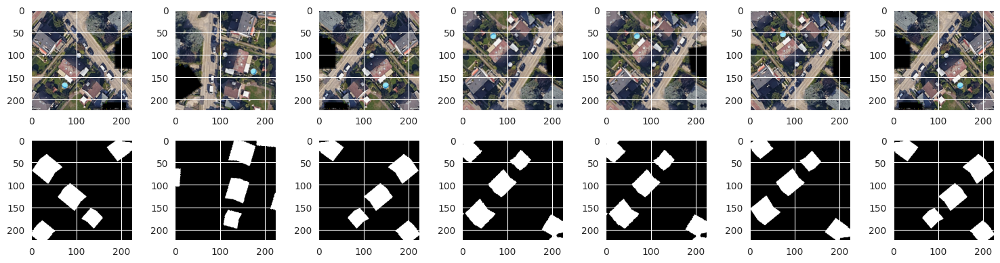

In [17]:
# Seeing the augmented images for an original image with any index between 1 to 20
idx = 15
st = 7*(idx)
fig, axs = plt.subplots(2, 7,figsize = (15,4))

for i,j in enumerate(range(st,st+7)):
    axs[0,i].imshow(train_aug_images[j])
    axs[1,i].imshow(train_aug_labels[j].squeeze(), cmap='gray')
fig.tight_layout()
#axs[1,7].imshow(processed_test_images[0])
plt.show()

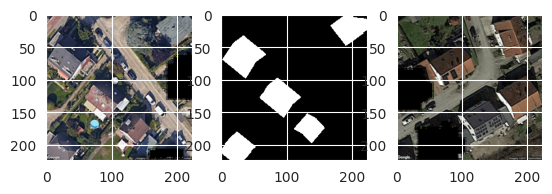

In [18]:
# Seeing the original image and corresponding label
fig, axs = plt.subplots(1, 3)
axs[0].imshow(processed_train_images[idx])
axs[1].imshow(processed_train_labels[idx].squeeze(), cmap='gray')
axs[2].imshow(processed_test_images[0])
plt.show()

## Model Training Section
- [Link To Loading, Augmenting and Visualizing Images Section](#Loading,-Augmenting-and-Visualizing-Images-Section)

- This section includes model architecture defining functions, training these models, calculating metrics of tpr, fpr, thresholds on validation sets, and storing important bits such as thresholds, trained architecture etc.
    - Model histories dictionary is used stores every models training, validation accuracy and losses.
    - Models dictionary stores, trained models, with it's metrics of tprs, fprs and threshold calculated on validation set.
    - Model Types Utilized: 
        - Models trained from Scratch: Used as base comparisions
            - [Base Cnn Model](#Base-CNN-Model:-Trained-From-Scratch): Convolutiona neural network, Extended with decoders 
            - [Base Unet Model](#Base-UNET:-Trained-From-Scratch): U-NET architecture implementation
        - Models built with Transfer Learning: 
            - [Pretrained VGG16](#Fine-Tuned-VGG16,-Combined-with-Unet): PowerFul feature extractor VGG16 extended with decoders, concatenated with conv blocks from VGG 16, similar to UNET.
            - [Pretrained MobileNet](#Fine-Tuned-MobileNet,-Combined-with-Unet): Light n efficient feature extractor MobileNetV2 extended with decoders and concatenated with conv blocks from MobileNet, similar to UNET
    - Every model is trained and validated on both Normal (non-augmented) and Augmented set of images, just for exploration and model comparisions.
        - I have **provided notes on why I followed a certain architecture blocks or certain params** near the architecture defining functions, or in comments, wherever I felt it's useful.

- The **models perform binary classification of the pixels** whether it's a part of roof or not, given an optimal threshold
- The codes which are commented except of cross validation, will be run in observations part to compare all models at one place
- Cross Validation wasn't that helpful, except providing information average performance on model from all folds, and performance on individual folds

- **Only CNN and Unets ROC curve seem to be good, but not of vgg and mobilenet ones. The main reason I have discussed in observations section**

- [Link To Observations Section](#Observations-Section)

In [19]:
# Model Fit parameters that can be changed all at once
epochs = 20
batch_size = 5

# I found these values, by simple obervations of few training runs, and these values learn as much as is possible, trying to also not overfit the data

### Base CNN Model: Trained From Scratch
- For any image task, the base architecture that comes in mind to use is a CNN architecture
- I am using CNN as the general base
- For segmentation task, I combined basic convolutional layers and transpose layers to perform segmentation on the images, with the basis of labels.
- I didn't make this architecture much deep since I am using it only as a base comparision
- This simple architecture does a pretty good job with decreasing loss, but in comparision with other models it's not able to learn features from images accurately
- Overall I think all the rest models performed better than CNN, in learning rooftop features just cause they were able to extract more features from images, and had a skip layer concatenation, which improved segmentation in general.

In [20]:
# Define the CNN model
def Cnn(input_size=(224, 224, 3), n_filters=16, n_classes=1, dropout_prob=0.5):
    '''
    Returns a CNN architecture
    @param: input_size: input size of image
    @param: n_filters: Number of filters to be used in architecture layers
    @param: n_classes: Total Classes to be predicted
    @param: dropout_prob: Dropout probabilities
    '''
    input_shape = input_size
    model = Sequential(name='CNN')

    # Dropouts are used to avoid overfitting
    # Using the HeNormal initializer in UNet for segmentation tasks can help address issues related to gradients, information flow, and non-linearities. 
    # It contributes to more stable training, better preservation of fine details, and improved segmentation performance. 

    # Downsampling an image by conv layers to extract feature maps from images
    model.add(Conv2D(n_filters*2, (5, 5), activation='relu', input_shape=input_shape, padding='valid', kernel_initializer='HeNormal'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_prob))
    model.add(Conv2D(n_filters*4, (3, 3), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_prob))
    model.add(Conv2D(n_filters*8, (3, 3), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(dropout_prob))
    model.add(Conv2D(n_filters*16, (3, 3), activation='relu', padding='same', kernel_initializer='HeNormal'))

    # Upsampling process to recover the spatial details and enhance the resolution of the feature maps to produce more accurate outputs.
    model.add(Conv2DTranspose(n_filters*8, (4, 4), strides=(2, 2), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(Dropout(dropout_prob))
    model.add(Conv2DTranspose(n_filters*4, (4, 4), strides=(2, 2), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(Dropout(dropout_prob))
    model.add(Conv2DTranspose(n_filters*2, (4, 4), strides=(2, 2), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(Dropout(dropout_prob))
    model.add(Conv2D(n_filters*4, (3, 3), activation='relu', padding='same', kernel_initializer='HeNormal'))
    model.add(Dropout(dropout_prob))

    # This layer produces the final image output, representing the predicted probabilities for each pixel.
    # The sigmoid activation function is used to ensure the output values are between 0 and 1, representing the class probabilities.
    model.add(Conv2D(n_classes, (3, 3), activation='sigmoid', padding='same', kernel_initializer='HeNormal'))

    # Adding padding to get an image of the same size as the label
    model.add(ZeroPadding2D(padding=((4, 4), (4, 4))))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

#### Loading and training the CNN model without augmented images

In [21]:
# Define the model
cnn = Cnn(dropout_prob = 0.6)

# Get the model info
## model_info(cnn)

# Getting images
imgs = img('normal')

# Train the model
h_cnn = cnn.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history 
model_histories['cnn'] = h_cnn

# Plotting the accuracy and loss for train and validation data
# We see all plots together at the end
# acc_loss_plot(h_cnn) 

Epoch 1/20


2023-05-17 17:43:01.022926: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inCNN/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


4/4 [==============================] - 11s 148ms/step - loss: 1.3126 - accuracy: 0.7490 - val_loss: 0.7164 - val_accuracy: 0.8497
Epoch 2/20
4/4 [==============================] - 0s 50ms/step - loss: 0.5499 - accuracy: 0.8367 - val_loss: 0.7084 - val_accuracy: 0.8497
Epoch 3/20
4/4 [==============================] - 0s 46ms/step - loss: 0.5283 - accuracy: 0.8520 - val_loss: 0.6857 - val_accuracy: 0.8497
Epoch 4/20
4/4 [==============================] - 0s 46ms/step - loss: 0.5103 - accuracy: 0.8548 - val_loss: 0.6732 - val_accuracy: 0.8497
Epoch 5/20
4/4 [==============================] - 0s 47ms/step - loss: 0.4980 - accuracy: 0.8559 - val_loss: 0.6607 - val_accuracy: 0.8497
Epoch 6/20
4/4 [==============================] - 0s 49ms/step - loss: 0.4905 - accuracy: 0.8563 - val_loss: 0.6412 - val_accuracy: 0.8497
Epoch 7/20
4/4 [==============================] - 0s 49ms/step - loss: 0.4794 - accuracy: 0.8564 - val_loss: 0.6241 - val_accuracy: 0.8497
Epoch 8/20
4/4 [====================

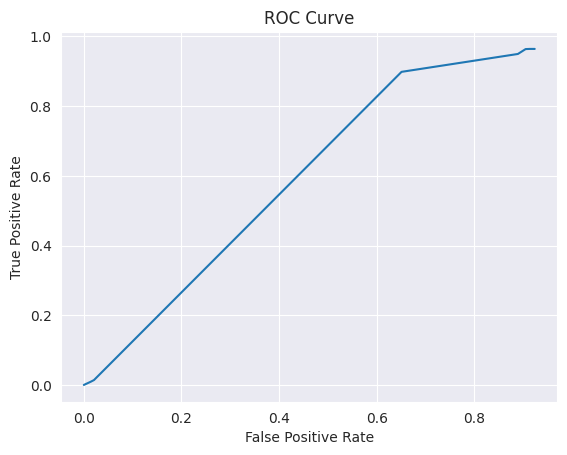

In [22]:
# Plotting the ROC curve
tprs,fprs = roc_curve(cnn,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['cnn'] = [cnn,tprs,fprs,threshold]

In [23]:
# Generating model scores on validation images with best threshold
# model_score(cnn,processed_val_images,processed_val_labels,tprs,fprs)

In [24]:
# Predictions on the test set by getting the best threshold from the ROC tprs, fprs values
# We do all predictions at the end.
# test_predictions(cnn,processed_test_images,threshold)

In [25]:
# # Observing the results of 5-fold Cross_Validation with Normal Images
# cv_cnn = Cnn()
# cv(m = cv_cnn, folds = 5,dataset = 'normal')

#### Loading and training the CNN model with augmented images

In [26]:
# Define the model
aug_cnn = Cnn(dropout_prob = 0.6)

# Getting images
imgs = img('augmented')

# Train the model
h_aug_cnn = aug_cnn.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history
model_histories['aug_cnn'] = h_aug_cnn
# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_aug_cnn)

Epoch 1/20


2023-05-17 17:43:16.838617: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inCNN/dropout_7/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


28/28 [==============================] - 5s 60ms/step - loss: 0.6230 - accuracy: 0.8360 - val_loss: 0.6390 - val_accuracy: 0.8456
Epoch 2/20
28/28 [==============================] - 1s 36ms/step - loss: 0.4877 - accuracy: 0.8549 - val_loss: 0.5257 - val_accuracy: 0.8456
Epoch 3/20
28/28 [==============================] - 1s 36ms/step - loss: 0.4699 - accuracy: 0.8549 - val_loss: 0.5167 - val_accuracy: 0.8456
Epoch 4/20
28/28 [==============================] - 1s 36ms/step - loss: 0.4646 - accuracy: 0.8549 - val_loss: 0.5212 - val_accuracy: 0.8456
Epoch 5/20
28/28 [==============================] - 1s 39ms/step - loss: 0.4479 - accuracy: 0.8549 - val_loss: 0.6083 - val_accuracy: 0.8456
Epoch 6/20
28/28 [==============================] - 1s 37ms/step - loss: 0.4115 - accuracy: 0.8549 - val_loss: 0.5116 - val_accuracy: 0.8456
Epoch 7/20
28/28 [==============================] - 1s 39ms/step - loss: 0.3772 - accuracy: 0.8549 - val_loss: 0.5121 - val_accuracy: 0.8456
Epoch 8/20
28/28 [======

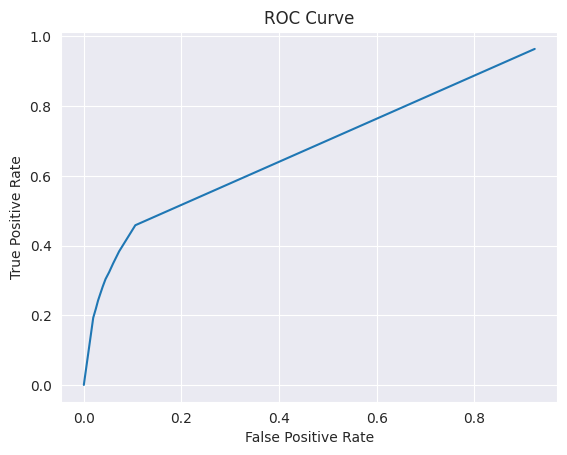

In [27]:
# Plotting the ROC curve
tprs,fprs = roc_curve(aug_cnn,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['aug_cnn'] = [aug_cnn,tprs,fprs,threshold]

In [28]:
# Generating model scores on validation images with best threshold
# model_score(aug_cnn,processed_val_images,processed_val_labels,tprs,fprs)

In [29]:
# Predictions on the test set
# test_predictions(aug_cnn,processed_test_images,threshold)

In [30]:
# # Observing the results of 5-fold Cross_Validation with Augmented Images
# cv_cnn = Cnn()
# cv(m = aug_cnn, folds = 5,dataset = 'augmented')

### Base UNET: Trained From Scratch
- Unet is an architecture which is specially developed for segmentatoin tasks
- I am using this model as a base especially segmentation task, like how complex models do in segmenting an image wrt a simple UNET
- The results are quite interesting when comparing UNET with pretrained models
    - Complex models do a good job at only getting a bit better wrt accuracy of marking a rooftop segmentation better by adding corners well
    - Whereas in terms of loss, they sometimes cross the loss of UNET 
- On Augmentation, the segmentation improves on the images.

In [31]:
def EncoderMiniBlock(inputs, n_filters:int=32, dropout_prob:float=0.3, max_pooling:bool=True):
    '''
    Return the encoding blocks to UNET architecture
    @param: inputs:  A prev layer architecture
    @param: n_filters: Number of filters to be used in conv layers
    @param: dropout_prob: Dropout Probabilities
    @param: max_pooling: Max pooling addition to encoder block
    '''
    conv = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='HeNormal')(inputs)
    conv = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='HeNormal')(conv)
    conv = BatchNormalization()(conv, training=False)

    if dropout_prob > 0:     
        conv = tf.keras.layers.Dropout(dropout_prob)(conv)
    if max_pooling:
        next_layer = tf.keras.layers.MaxPooling2D(pool_size = (2,2))(conv)    
    else:
        next_layer = conv

    skip_connection = conv    
    return next_layer, skip_connection

def DecoderMiniBlock(prev_layer_input, skip_layer_input, n_filters:int=32):
    '''
    Return the encoding blocks to UNET architecture
    @param: prev_layer_input:  A prev layer architecture
    @param: skip_layer_input: Conv Layers to be linked to Transpose layer
    @param: n_filtes: Number of filters to be used in transpose and conv layers
    '''
    up = Conv2DTranspose(n_filters, (3,3), strides=(2,2), padding='same')(prev_layer_input)
    merge = concatenate([up, skip_layer_input],axis = 3)
    conv = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='HeNormal')(merge)
    conv = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='HeNormal')(conv)
    return conv

In [32]:
# Defining the UNET using the encoder and decoder functions
def Unet(input_size=(224, 224, 3), n_filters=16, n_classes=1,dropout_prob = 0):
    '''
    Returns a Unet Architecture Model
    @param: input_size: input size of image
    @param: n_filters: Number of filters to be used in architecture layers
    @param: n_classes: Total Classes to be predicted
    @param: dropout_prob: Dropout probabilities
    '''
    # Input size represent the size of 1 image (the size used for pre-processing)
    inputs = Input(input_size)

    # Encoder includes multiple convolutional mini blocks with different maxpooling, dropout and filter parameters
    # keeping dropout to be 0 because we have small dataset itsels n we want to extract more features
    # I didn't see overfitting with the architecture for 0 dropout, but with high dropout, model underfits.
    

    # We increase n_filters per layer to extract more features
    cblock1 = EncoderMiniBlock(inputs, n_filters,dropout_prob=0, max_pooling=True)
    cblock2 = EncoderMiniBlock(cblock1[0],n_filters*2,dropout_prob=0, max_pooling=True)
    cblock3 = EncoderMiniBlock(cblock2[0], n_filters*4,dropout_prob=0, max_pooling=True)
    cblock4 = EncoderMiniBlock(cblock3[0], n_filters*8,dropout_prob=dropout_prob, max_pooling=True)
    cblock5 = EncoderMiniBlock(cblock4[0], n_filters*16, dropout_prob=dropout_prob, max_pooling=False) 

    # Decoder includes multiple mini blocks with decreasing number of filters
    # Skip connections from the encoder are given as input to the decoder
    # Recall the 2nd output of encoder block was skip connection, hence cblockn[1] is used
    ublock6 = DecoderMiniBlock(cblock5[0], cblock4[1],  n_filters * 8)
    ublock7 = DecoderMiniBlock(ublock6, cblock3[1],  n_filters * 4)
    ublock8 = DecoderMiniBlock(ublock7, cblock2[1],  n_filters * 2)
    ublock9 = DecoderMiniBlock(ublock8, cblock1[1],  n_filters)

    # Complete the model with 1 3x3 convolution layer (Same as the prev Conv Layers)
    # Followed by a 1x1 Conv layer to get the image to the desired size. 
    # Observe the number of channels will be equal to number of output classes
    conv9 = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='he_normal')(ublock9)

    conv10 = Conv2D(n_classes, (1,1), padding='same', activation = 'sigmoid')(conv9)
    # This layer produces the final image output, representing the predicted probabilities for each pixel.
    # The sigmoid activation function is used to ensure the output values are between 0 and 1, representing the class probabilities.

    # Define the model
    model = Model(inputs=inputs, outputs=conv10,name = 'UNET')
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

#### Loading and training the Unet model without augmented images

In [33]:
# Define the model
unet = Unet(dropout_prob = 0.0)

# Getting images
imgs = img('normal')

#Train the model
h_unet = unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history
model_histories['unet'] = h_unet

# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_unet)

Epoch 1/20
4/4 [==============================] - 11s 179ms/step - loss: 0.5986 - accuracy: 0.7389 - val_loss: 0.4927 - val_accuracy: 0.8497
Epoch 2/20
4/4 [==============================] - 0s 46ms/step - loss: 0.4777 - accuracy: 0.8565 - val_loss: 0.4898 - val_accuracy: 0.8497
Epoch 3/20
4/4 [==============================] - 0s 47ms/step - loss: 0.4656 - accuracy: 0.8566 - val_loss: 0.4742 - val_accuracy: 0.8497
Epoch 4/20
4/4 [==============================] - 0s 44ms/step - loss: 0.4497 - accuracy: 0.8566 - val_loss: 0.4579 - val_accuracy: 0.8497
Epoch 5/20
4/4 [==============================] - 0s 44ms/step - loss: 0.4272 - accuracy: 0.8566 - val_loss: 0.4559 - val_accuracy: 0.8497
Epoch 6/20
4/4 [==============================] - 0s 44ms/step - loss: 0.4274 - accuracy: 0.8566 - val_loss: 0.4358 - val_accuracy: 0.8497
Epoch 7/20
4/4 [==============================] - 0s 44ms/step - loss: 0.3992 - accuracy: 0.8566 - val_loss: 0.4282 - val_accuracy: 0.8497
Epoch 8/20
4/4 [=========

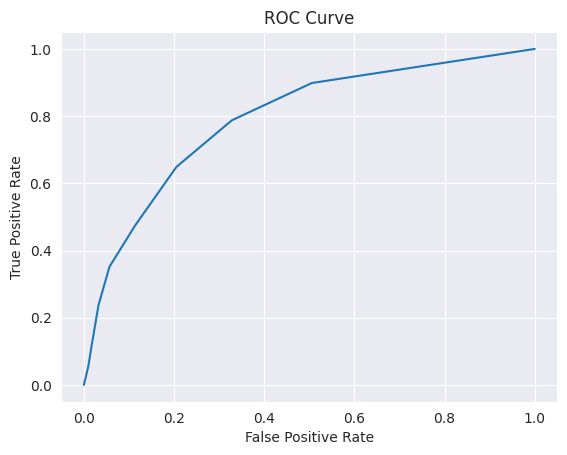

In [34]:
# Plotting the ROC curve
tprs,fprs = roc_curve(unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['unet'] = [unet,tprs,fprs,threshold]

In [35]:
#  # Generating model scores on validation images with best threshold
#model_score(unet,processed_val_images,processed_val_labels,tprs,fprs)

In [36]:
# # # Predictions on the test set
# test_predictions(unet,processed_test_images,threshold)

In [37]:
# # Observing the results of 5-fold Cross_Validation with Normal Images
# cv_unet = Unet()
# cv(m = cv_unet, folds = 5, dataset = 'normal')

#### Loading and training the Unet model with augmented images

In [38]:
# Define the model
aug_unet = Unet(dropout_prob = 0.0)

# Getting images
imgs = img('augmented')

# Train the model
h_aug_unet = aug_unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history
model_histories['aug_unet'] = h_aug_unet

# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_aug_unet)

Epoch 1/20
28/28 [==============================] - 11s 50ms/step - loss: 0.5466 - accuracy: 0.7782 - val_loss: 0.4807 - val_accuracy: 0.8456
Epoch 2/20
28/28 [==============================] - 1s 33ms/step - loss: 0.3834 - accuracy: 0.8565 - val_loss: 0.4409 - val_accuracy: 0.8477
Epoch 3/20
28/28 [==============================] - 1s 37ms/step - loss: 0.3144 - accuracy: 0.8838 - val_loss: 0.4022 - val_accuracy: 0.8468
Epoch 4/20
28/28 [==============================] - 1s 40ms/step - loss: 0.3054 - accuracy: 0.8843 - val_loss: 0.4685 - val_accuracy: 0.8460
Epoch 5/20
28/28 [==============================] - 1s 37ms/step - loss: 0.2685 - accuracy: 0.8901 - val_loss: 0.5299 - val_accuracy: 0.8456
Epoch 6/20
28/28 [==============================] - 1s 36ms/step - loss: 0.2553 - accuracy: 0.8949 - val_loss: 0.4676 - val_accuracy: 0.8455
Epoch 7/20
28/28 [==============================] - 1s 33ms/step - loss: 0.2296 - accuracy: 0.9051 - val_loss: 0.4411 - val_accuracy: 0.8500
Epoch 8/20
2

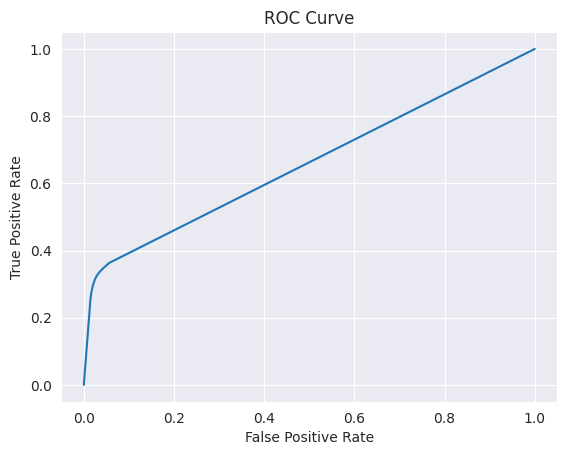

In [39]:
# Plotting the ROC curve
tprs,fprs = roc_curve(aug_unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['aug_unet'] = [aug_unet,tprs,fprs,threshold]

In [40]:
# # Generating model scores on validation images with best threshold
# model_score(aug_unet,processed_val_images,processed_val_labels,tprs,fprs)

In [41]:
# # Predictions on the test set
# test_predictions(aug_unet,processed_test_images,threshold)

In [42]:
# # Observing the results of 5-fold Cross_Validation with Augmented Images
# cv_unet = Unet()
# cv(m = cv_unet, folds = 5,dataset = 'augmented')

### Fine Tuned VGG16, Combined with Unet
- VGG16, was my first choice with transfer learning, given it's powerful feature extraction with the pretrained waits of initial layers
    - This helps to recover good features from the images, to be later used in skip layers in decoders
- I trained the conv5 layer of VGG16, to adapt model to problem at hand and this architecture was extended by combining it with UNET Decoders, to do proper segmentation of images
- The results in comparision to UNET were better in terms of mapping corners of rooftops especially when augmented images were used

In [43]:
# Convolution Architecture layers name for VGG16, used in VGG_Unet architecture
conv1 = ['block1_conv1','block1_conv2']
conv2 = ['block2_conv1','block2_conv2']
conv3 = ['block3_conv1','block3_conv2','block3_conv3']
conv4 = ['block4_conv1','block4_conv2','block4_conv3']
conv5 = ['block5_conv1','block5_conv2','block5_conv3']
pool1 = ['block1_pool']
pool2 = ['block2_pool']
pool3 = ['block3_pool']
pool4 = ['block4_pool']
pool5 = ['block5_pool']

In [44]:
def Vgg_Unet(input_size=(224, 224, 3), n_filters=16, n_classes=1,dropout_prob = 0):
    '''
    Returns a VGG Unet Architecture Model
    @param: input_size: input size of image
    @param: n_filters: Number of filters to be used in architecture layers
    @param: n_classes: Total Classes to be predicted
    @param: dropout_prob: Dropout probabilities
    '''

    # Loading a pretrained VGG 16 model
    VGG16 = vgg16.VGG16(include_top = False, weights = 'imagenet',input_shape = input_size)
    last_layer = VGG16.output

    # Defining which layers to train and which not to, since we have less images it's a good strategy to freeze the initial layers and only fine tune the last layer.
    train_layers =  conv5 
    non_train_layers = ['input_21'] + pool1 + pool2 + pool3 + pool4 + pool5+conv1 + conv2  + conv3 + conv4

    for layer in VGG16.layers:
        if layer.name in train_layers:
            layer.trainable = True
        if layer.name in non_train_layers:
            layer.trainable = False

    # Extending the VGG16 via unet's decoder block, similar to UNET Decoder Architecture Explanation.
    last_layer = VGG16.output
    unet = DecoderMiniBlock(last_layer,VGG16.get_layer("block5_conv3").output, n_filters*32)
    unet = DecoderMiniBlock(unet,VGG16.get_layer("block4_conv3").output, n_filters*32)
    unet = DecoderMiniBlock(unet,VGG16.get_layer("block3_conv3").output, n_filters*16)
    unet = DecoderMiniBlock(unet,VGG16.get_layer("block2_conv2").output, n_filters*8)
    unet = DecoderMiniBlock(unet,VGG16.get_layer("block1_conv2").output, n_filters*4)

    # Adding few final conv layers to get image output with the same size as that of the labels
    conv9 = Conv2D(n_filters*2, (3,3), activation='relu', padding='same', kernel_initializer='he_normal')(unet)
    conv10 = Conv2D(n_filters, (3,3), activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    conv11 = Conv2D(n_classes, (1,1), activation='sigmoid', padding='same', kernel_initializer='he_normal')(conv10)
    # This layer produces the final image output, representing the predicted probabilities for each pixel.
    # The sigmoid activation function is used to ensure the output values are between 0 and 1, representing the class probabilities.

    model = Model(VGG16.input, conv11)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

#### Loading and training the VGG combined with UNET model without augmented images

In [45]:
# Define the model
vgg_unet = Vgg_Unet()

# Getting images
imgs = img('normal')

# Train the model
h_vgg_unet = vgg_unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history
model_histories['vgg_unet'] = h_vgg_unet
# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_vgg_unet)

58889256/58889256 [==============================] - 0s 0us/step
Epoch 1/20
4/4 [==============================] - 11s 321ms/step - loss: 2.2032 - accuracy: 0.7654 - val_loss: 0.5562 - val_accuracy: 0.7337
Epoch 2/20
4/4 [==============================] - 1s 141ms/step - loss: 0.5366 - accuracy: 0.8078 - val_loss: 0.6923 - val_accuracy: 0.7905
Epoch 3/20
4/4 [==============================] - 1s 140ms/step - loss: 0.5264 - accuracy: 0.8355 - val_loss: 0.4402 - val_accuracy: 0.8454
Epoch 4/20
4/4 [==============================] - 1s 146ms/step - loss: 0.4239 - accuracy: 0.8521 - val_loss: 0.4392 - val_accuracy: 0.8456
Epoch 5/20
4/4 [==============================] - 1s 145ms/step - loss: 0.4168 - accuracy: 0.8523 - val_loss: 0.4284 - val_accuracy: 0.8457
Epoch 6/20
4/4 [==============================] - 1s 145ms/step - loss: 0.4035 - accuracy: 0.8527 - val_loss: 0.4193 - val_accuracy: 0.8486
Epoch 7/20
4/4 [==============================] - 1s 145ms/step - loss: 0.3883 - accuracy: 0.8

In [46]:
# from tensorflow.keras.utils import plot_model
# plot_model(vgg_unet, to_file='UNET with VGG16.png', show_shapes=True, rankdir='TB')
# layers = [(layer, layer.name, layer.trainable,layer.output.shape) for layer in vgg_unet.layers]
# pd.DataFrame(layers, columns=['Layer Type', 'Layer Name', 'Layer Trainable', 'Layer Op'])

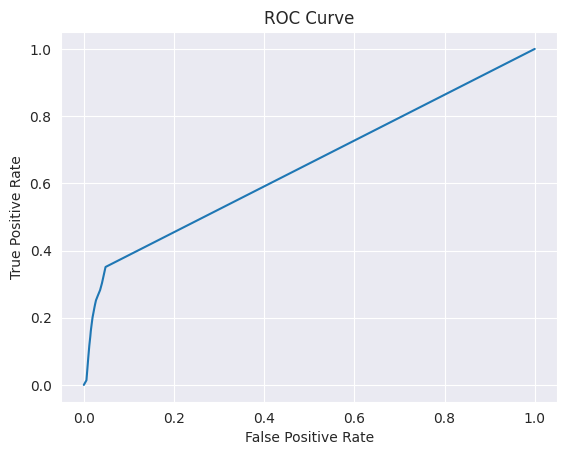

In [47]:
# Plotting the ROC curve
tprs,fprs = roc_curve(vgg_unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['vgg_unet'] = [vgg_unet,tprs,fprs,threshold]

In [48]:
# # Generating model scores on validation images with best threshold
# model_score(vgg_unet,processed_val_images,processed_val_labels,tprs,fprs)

In [49]:
# # Predictions on the test set
# test_predictions(vgg_unet,processed_test_images,threshold)

In [50]:
# # Observing the results of 5-fold Cross_Validation with Normal Images
# cv_vgg_unet = Vgg_Unet()
# cv(m = vgg_unet, folds = 5, dataset = 'normal')

#### Loading and training the VGG combined with UNET model with augmented images

In [51]:
# Define the model
aug_vgg_unet = Vgg_Unet()

# Getting images
imgs = img('augmented')

# Train the model
h_aug_vgg_unet = aug_vgg_unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the history
model_histories['aug_vgg_unet'] = h_aug_vgg_unet

# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_aug_vgg_unet)

Epoch 1/20
28/28 [==============================] - 12s 157ms/step - loss: 0.5269 - accuracy: 0.8219 - val_loss: 0.6534 - val_accuracy: 0.8456
Epoch 2/20
28/28 [==============================] - 4s 140ms/step - loss: 0.2774 - accuracy: 0.8912 - val_loss: 0.3982 - val_accuracy: 0.8555
Epoch 3/20
28/28 [==============================] - 4s 129ms/step - loss: 0.1677 - accuracy: 0.9360 - val_loss: 0.4309 - val_accuracy: 0.8589
Epoch 4/20
28/28 [==============================] - 4s 140ms/step - loss: 0.1107 - accuracy: 0.9579 - val_loss: 0.4779 - val_accuracy: 0.8572
Epoch 5/20
28/28 [==============================] - 4s 140ms/step - loss: 0.0687 - accuracy: 0.9737 - val_loss: 0.6505 - val_accuracy: 0.8619
Epoch 6/20
28/28 [==============================] - 4s 141ms/step - loss: 0.0572 - accuracy: 0.9775 - val_loss: 0.6545 - val_accuracy: 0.8590
Epoch 7/20
28/28 [==============================] - 4s 140ms/step - loss: 0.0443 - accuracy: 0.9823 - val_loss: 0.8844 - val_accuracy: 0.8643
Epoch

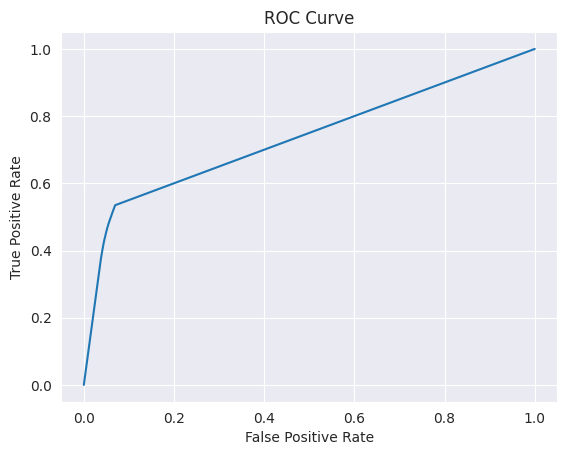

In [52]:
# Plotting the ROC curve
tprs,fprs = roc_curve(aug_vgg_unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['aug_vgg_unet'] = [aug_vgg_unet,tprs,fprs,threshold]

In [53]:
# # Generating model scores on validation images with best threshold
# model_score(aug_vgg_unet,processed_val_images,processed_val_labels,tprs,fprs)

In [54]:
# # Predictions on the test set
# test_predictions(aug_vgg_unet,processed_test_images,threshold)

In [55]:
# # Observing the results of 5-fold Cross_Validation with Augmented Images
# cv_vgg_unet = Vgg_Unet()
# cv(m = cv_vgg_unet,folds = 5,dataset = 'augmented')

### Fine Tuned MobileNet, Combined with Unet
- Mobilenet was a lightweight experimentation alternative of VGG16, for quick and efficient training.
- Turns out that it performs good with augmented images, as compared to basic UNET but a bit poor than VGG_UNET.
    - This can be seen especially in predictions where Mobilenet puts sparkles in no-roof places, and is not able to map roof linings well
    - Mobilenet does a good job at getting an irregular square shape of rooftops, which is better than UNET.

In [56]:
def mobunet_model(input_size=(224, 224, 3), n_filters=16, n_classes=1,dropout_prob = 0):
    '''
    Returns a MobUnet Architecture Model
    @param: input_size: input size of image
    @param: n_filters: Number of filters to be used in architecture layers
    @param: n_classes: Total Classes to be predicted
    @param: dropout_prob: Dropout probabilities
    '''  
    # Using a whole pretrained mobileNet V2 architecture
    base_model = MobileNetV2(input_shape=[224, 224, 3], include_top=False)

    # Specify the layers whose activations will be used as skip connections
    layer_names = [
        'block_1_expand_relu',   # 64x64
        'block_3_expand_relu',   # 32x32
        'block_6_expand_relu',   # 16x16
        'block_13_expand_relu',  # 8x8
        'block_16_project',      # 4x4
    ]

    # Retrieve the output tensors of the specified layers
    base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

    # Create the feature extraction model
    down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)
    down_stack.trainable = False

    # Define the upsampling layers
    up_stack = [
        pix2pix.upsample(512, 3),  # 4x4 -> 8x8
        pix2pix.upsample(256, 3),  # 8x8 -> 16x16
        pix2pix.upsample(128, 3),  # 16x16 -> 32x32
        pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    ]

    # Define the input layer
    inputs = Input(shape=input_size)

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

    # Append another Conv2DTranspose layer with appropriate parameters
    x = tf.keras.layers.Conv2DTranspose(filters=64, kernel_size=(3,3), strides=2, padding='same')(x)

    x = tf.keras.layers.Conv2D( filters=n_classes, kernel_size=(1,1), strides=1, padding='valid')(x)


    # Apply sigmoid activation function to obtain pixel-wise probabilities
    x = tf.keras.activations.sigmoid(x)

    x = Model(inputs = inputs, outputs = x)
    x.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return x

#### Loading and training the MobileNet combined with UNET model without augmented images

In [57]:
# Define the model
mob_unet = mobunet_model()

# Getting images
imgs = img('normal')

# Train the model
h_mob_unet = mob_unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the History
model_histories['mob_unet'] = h_mob_unet

# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_mob_unet)

9406464/9406464 [==============================] - 0s 0us/step
Epoch 1/20
4/4 [==============================] - 7s 424ms/step - loss: 0.7148 - accuracy: 0.7186 - val_loss: 0.6940 - val_accuracy: 0.8497
Epoch 2/20
4/4 [==============================] - 0s 52ms/step - loss: 0.6170 - accuracy: 0.8582 - val_loss: 0.6070 - val_accuracy: 0.8230
Epoch 3/20
4/4 [==============================] - 0s 52ms/step - loss: 0.3963 - accuracy: 0.8864 - val_loss: 0.5209 - val_accuracy: 0.7945
Epoch 4/20
4/4 [==============================] - 0s 52ms/step - loss: 0.2413 - accuracy: 0.9196 - val_loss: 0.7810 - val_accuracy: 0.7486
Epoch 5/20
4/4 [==============================] - 0s 53ms/step - loss: 0.2007 - accuracy: 0.9322 - val_loss: 0.6944 - val_accuracy: 0.7938
Epoch 6/20
4/4 [==============================] - 0s 52ms/step - loss: 0.1399 - accuracy: 0.9498 - val_loss: 0.7219 - val_accuracy: 0.7996
Epoch 7/20
4/4 [==============================] - 0s 53ms/step - loss: 0.1253 - accuracy: 0.9548 - val

In [58]:
# from tensorflow.keras.utils import plot_model
# plot_model(mob_unet, to_file='UNET_Mob.png', show_shapes=True, rankdir='TB')
# layers = [(layer, layer.name, layer.trainable,layer.output) for layer in mob_unet.layers]
# pd.DataFrame(layers, columns=['Layer Type', 'Layer Name', 'Layer Trainable', 'Layer Op'])

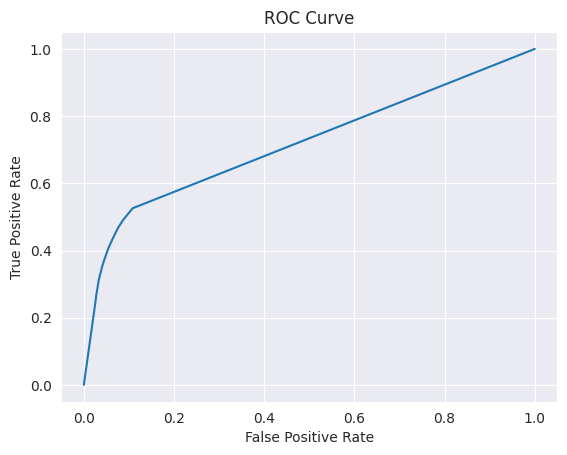

In [59]:
# Plotting the ROC curve
tprs,fprs = roc_curve(mob_unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['mob_unet'] = [mob_unet,tprs,fprs,threshold]

In [60]:
# Predictions on the test set
# test_predictions(mob_unet,processed_test_images,threshold)

In [61]:
# # Observing the results of 5-fold Cross_Validation with Normal Images
# cv_mob_unet = mobunet_model()
# cv(m = cv_mob_unet,folds =  5, dataset = 'normal')

#### Loading and training the MobileNet combined with UNET model with augmented images

In [62]:
# Define the model
aug_mob_unet = mobunet_model()

# Getting images
imgs = img('augmented')

# Train the model
h_aug_mob_unet = aug_mob_unet.fit(imgs[0],imgs[1],epochs=epochs, batch_size=batch_size, validation_data = (imgs[2],imgs[3]))

# Storing the History
model_histories['aug_mob_unet'] = h_aug_mob_unet

# Plotting the accuracy and loss for train and validation data
# acc_loss_plot(h_aug_mob_unet)

Epoch 1/20
28/28 [==============================] - 8s 82ms/step - loss: 0.3832 - accuracy: 0.8732 - val_loss: 1.2302 - val_accuracy: 0.6098
Epoch 2/20
28/28 [==============================] - 1s 40ms/step - loss: 0.1497 - accuracy: 0.9422 - val_loss: 0.9897 - val_accuracy: 0.7457
Epoch 3/20
28/28 [==============================] - 1s 41ms/step - loss: 0.1206 - accuracy: 0.9526 - val_loss: 0.8643 - val_accuracy: 0.7448
Epoch 4/20
28/28 [==============================] - 1s 41ms/step - loss: 0.1061 - accuracy: 0.9585 - val_loss: 0.8438 - val_accuracy: 0.7611
Epoch 5/20
28/28 [==============================] - 1s 43ms/step - loss: 0.0919 - accuracy: 0.9638 - val_loss: 0.6516 - val_accuracy: 0.8623
Epoch 6/20
28/28 [==============================] - 1s 41ms/step - loss: 0.0842 - accuracy: 0.9672 - val_loss: 0.7040 - val_accuracy: 0.8422
Epoch 7/20
28/28 [==============================] - 1s 40ms/step - loss: 0.0748 - accuracy: 0.9709 - val_loss: 0.7494 - val_accuracy: 0.8252
Epoch 8/20
28

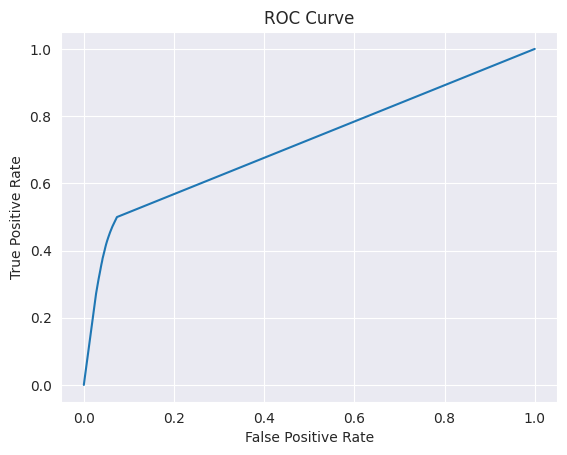

In [63]:
# Plotting the ROC curve 
tprs,fprs = roc_curve(aug_mob_unet,processed_val_images,processed_val_labels)

# Get best threshold on base of tprs and fprs
threshold = thr_calc(tprs,fprs)

# Storing the model, tprs, fprs
models['aug_mob_unet'] = [aug_mob_unet,tprs,fprs,threshold]

In [64]:
# Generating model scores on validation images with best threshold
# model_score(aug_mob_unet,processed_val_images,processed_val_labels,tprs,fprs)

In [65]:
# Predictions on the test set
# test_predictions(aug_mob_unet,processed_test_images,threshold)

In [66]:
# # Observing the results of 5-fold Cross_Validation with Augmented Images
# cv_mob_unet = mobunet_model()
# cv(m = cv_mob_unet, folds = 5,datset = 'augmented')

## Observations Section
- [Link To Model Training Section](#Model-Training-Section)

- This section is used to compare models on base of their training, validation accuracy and loss plots, ROC Curve and evaluate them on metrics of precision, recall and f1 score
    - Observations are stated in a bit more detail regarding metrics in the section itself
    - With observations 3 best models are chosen with their corresponding threshold

- [Link To Best Models Section](#Best-Models-Section)

### Observations from Model Training
- By  looking at the val_accuracy, val_loss from model training we can infer:
    - All models accuracy stay in range of 85(seen mostly on normal images) to 87(seen mostly on augmented images) on average
    - For every model except CNN, the val loss increases quite a bit when augmented images are provided to model. This is more visible in transfer learning architectures.
- Train Accuracy increases and Train losses decreases for every model over training and this trend increases more given the augmented images.

- **Observation 1** From Training and Validation data
  - Given these trends, it becomes really hard to compare between the models on base of accuracy or loss. Also as we have converted our problem into binary classification, in an image, **the class ration of roof-no-roof is imbalanced**. Hence I decided to use metrics of precision, recall and f1-score, which are calculated by making pixel wise prediction on validation set.

### Plots

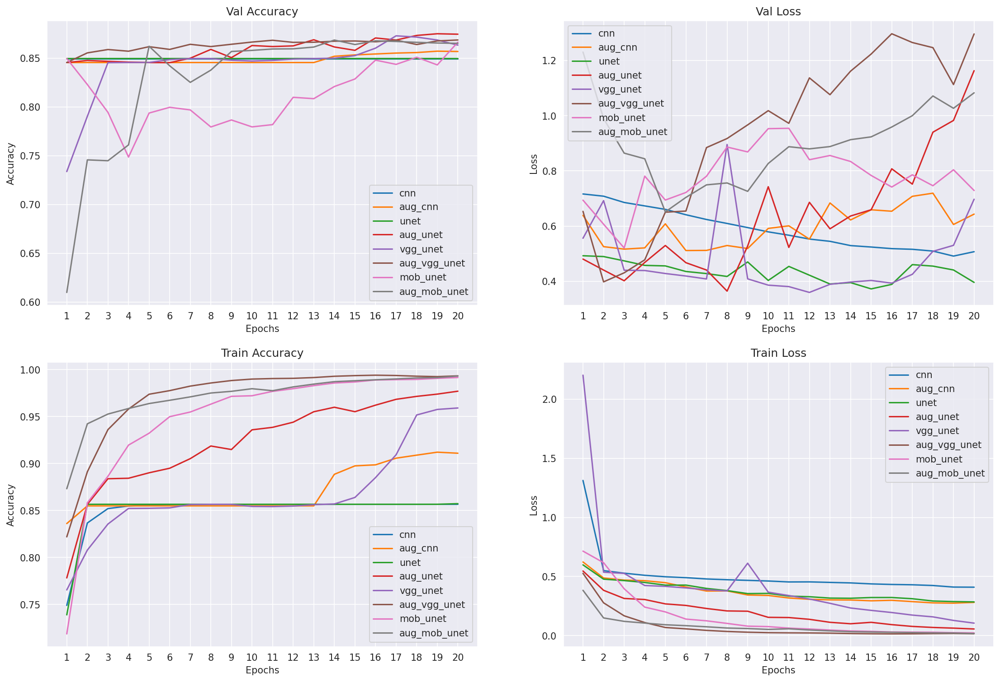

In [67]:
joint_plots(model_histories,epochs = epochs)

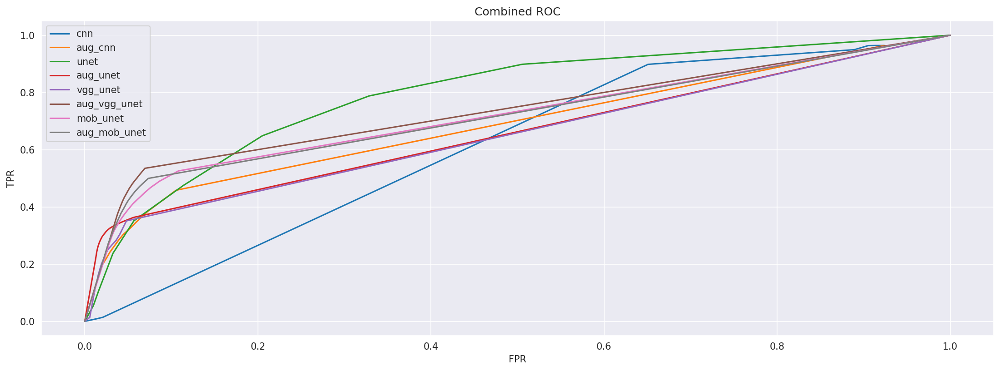

In [68]:
joint_roc(models)

 cnn predictions for threshold value: 0.25


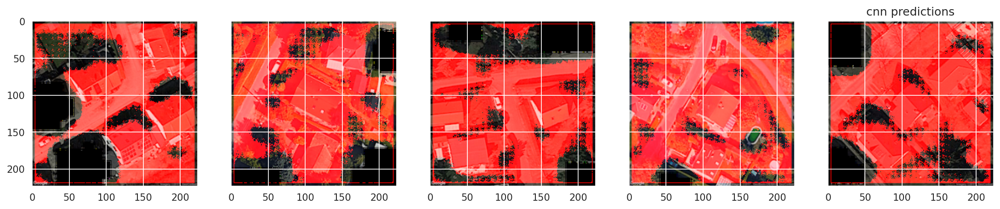

 aug_cnn predictions for threshold value: 0.05


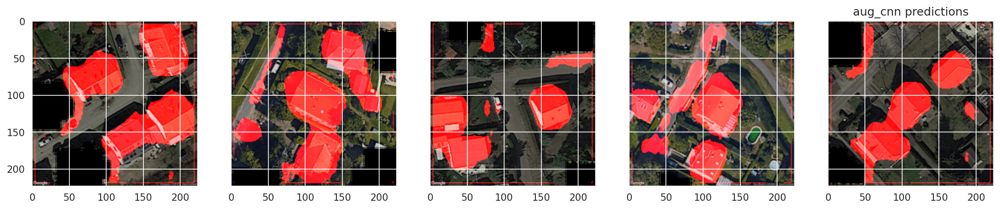

 unet predictions for threshold value: 0.1


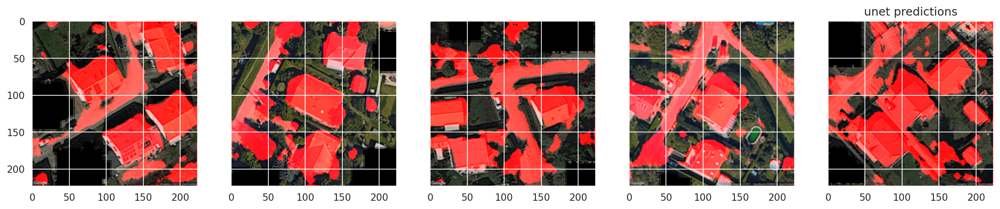

 aug_unet predictions for threshold value: 0.05


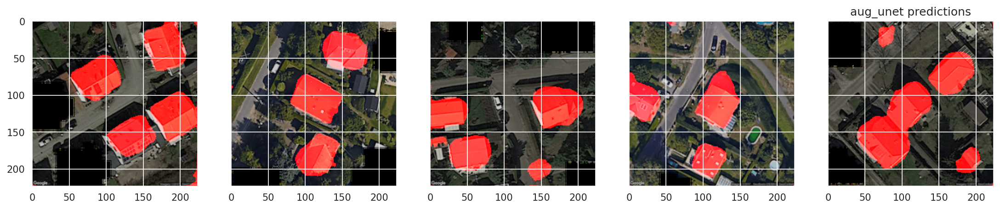

 vgg_unet predictions for threshold value: 0.05


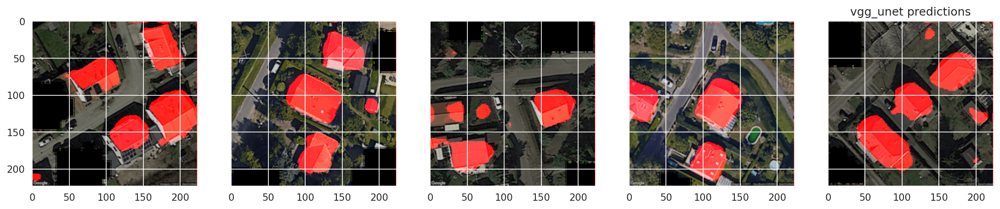

 aug_vgg_unet predictions for threshold value: 0.05


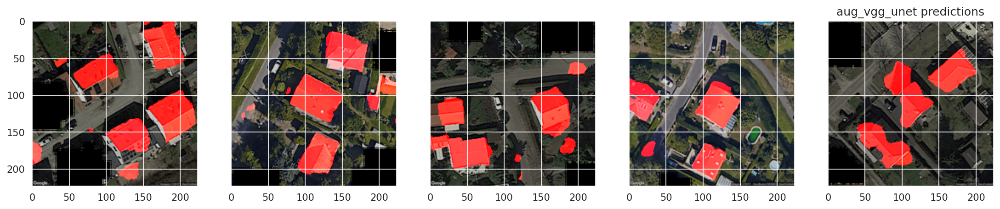

 mob_unet predictions for threshold value: 0.05


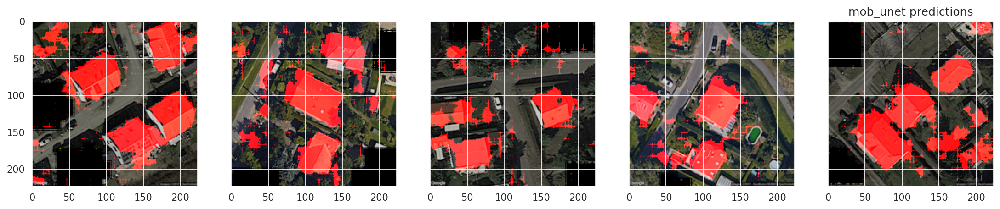

 aug_mob_unet predictions for threshold value: 0.05


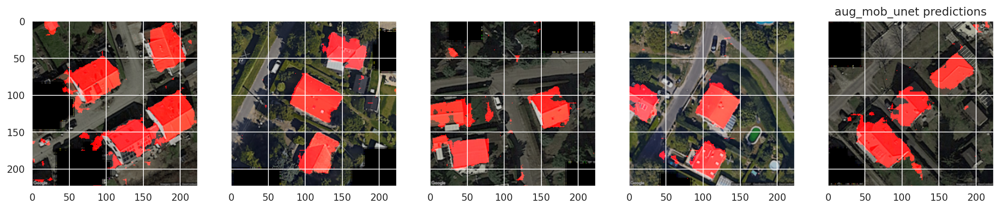

In [69]:
joint_preds(models,processed_test_images)

In [70]:
joint_metrics(models)

cnn metrics
Precision: 0.1962289289231304
Recall: 0.8982790167325183
F1 Score: 0.32209602502602913
aug_cnn metrics
Precision: 0.4344295268265701
Recall: 0.45819522155339293
F1 Score: 0.44599599922565664
unet metrics
Precision: 0.2979098968989449
Recall: 0.7876746837792686
F1 Score: 0.432312853389997
aug_unet metrics
Precision: 0.5329467170046316
Recall: 0.3631036037230516
F1 Score: 0.43192858494732195
vgg_unet metrics
Precision: 0.5632765957446808
Recall: 0.3510116411657076
F1 Score: 0.43250396170622923
aug_vgg_unet metrics
Precision: 0.5767515012868173
Recall: 0.5348306860067354
F1 Score: 0.5550006191439303
mob_unet metrics
Precision: 0.46204935797348
Recall: 0.5257617140887274
F1 Score: 0.49185085956686764
aug_mob_unet metrics
Precision: 0.5460394748282758
Recall: 0.4995889793428973
F1 Score: 0.5217824798515523


### Observations from the metric values and prediction plots
- **Observation 2** From Accuracy, Loss and ROC Plots
    - CNN, Unet gets stuck in val accuracy after 7 to 8 epochs for normal image set
    - Rest All models both on normal and augmented have a small increase in accuracy per epoch
    - Loss Plots are not that good cause of too much variance
    - The main reason I feel why ROC curves are pretty awesome for base CNN and base Unet because:
        - They are simple models without much possibility to overfit
        - Transfer learning architectures are keeping their pretrained weights (to make it more accuracte to identifying features), 
            along with deep network so after a certain threshold, they start overfitting and scrambles the curve of ROC

- **Observation 3** From Prediction Plots 
    - Predictions are always better for models trained on augmented images so we directly compare them
    - aug_unet does a good job to draw circles on roofs
    - aug_vgg_unet does even a better job in estimating corners as well with roofs
    - aug_mob_unet does a good job, but has blurry borders on roofs, and also a bit of mis-classification on small patches in images.

- **Observation 4** From Metric Scores
    - By being inline with observation 1 and with this understanding 
        - For rooftop classification, let's consider an onsite engineer, is going to visit the areas where we have more rooftops, so if our model is producing more FN's we are missing more rooftop areas, while if FP's are more, we just miss a trip of engineer, not an actual client. So I am assuming FN should be less, i.e. Recall has to be higher.
    - Also to balance this since I am not completely knowing usecase I will F-1 Score as second parameter of choice.
    - Models with good F-1 Score: aug_vgg_unet, aug_unet, aug_mob_unet

## Best Models Section
- [Link To Observations Section](#Observations-Section)

- This section simply includes training of best models on whole training data both normal and augmented. After training visual prediction plots are generated with optimal threshold values obtained during model predictions on validation sets.

- [Link To References and Conculsion Section](#References-and-Conclusions-Section)

### By above observations, we have 3 best models vgg_unet, unet, mob_unet, lets train them on whole training data

In [71]:
# Directories of images
train_image_path = '/kaggle/input/rooftop-without-validation-images/dida_task_dummy/train/images'
train_label_path = '/kaggle/input/rooftop-without-validation-images/dida_task_dummy/train/labels'
#val_image_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/val/images/'
#val_label_path = '/kaggle/input/rooftopclassification-with-25-imgs/Dida_task/val/labels/'
test_image_path = '/kaggle/input/rooftop-without-validation-images/dida_task_dummy/test/images'

# Loading the images from dirs
# We are choosing this size of 224 so that Maxpooling works well
train_images = train_test_img_loader(train_image_path,224) 
#val_images = train_test_img_loader(val_image_path,224)
train_labels = label_img_loader(train_label_path,224)
#val_labels = label_img_loader(val_label_path,224)
test_images = train_test_img_loader(test_image_path,224)

# Normalizing the images and making label images having enough channels for NN.
processed_train_images = train_images.astype('float32')
#processed_val_images = val_images.astype('float32')
processed_test_images = test_images.astype('float32')
processed_train_labels = train_labels
#processed_val_labels = val_labels

# Augmenting the images, generating 6 augmentations per image
# Chosen 6 as lower than that decreases performance and higher than that overfits the model
train_aug_images, train_aug_labels = augment_images(processed_train_images,processed_train_labels,num_aug = 6)

#val_aug_images, val_aug_labels = augment_images(processed_val_images,processed_val_labels,num_aug = 6)

In [72]:
print(train_aug_images.shape, train_aug_labels.shape)

(175, 224, 224, 3) (175, 224, 224, 1)


In [73]:
epochs = 20
batch_size = 5
bst_models = {}
# bs: stands for base
# bst: stands for base transformed, i.e model uses transformed images

### Training the models on normal images

#### Unet

In [74]:
# Define a model
bs_unet = Unet()

# Train the model
hbs_unet = bs_unet.fit(processed_train_images,processed_train_labels, epochs = epochs, batch_size = batch_size)
thr = models['unet'][3] #Getting the thereshold value from the trained models dictionary

# Storing the models information
model_histories['bs_unet'] = hbs_unet
bst_models['bs_unet'] = [bs_unet,thr]

Epoch 1/20
5/5 [==============================] - 10s 33ms/step - loss: 0.7397 - accuracy: 0.3010
Epoch 2/20
5/5 [==============================] - 0s 31ms/step - loss: 0.6694 - accuracy: 0.8190
Epoch 3/20
5/5 [==============================] - 0s 31ms/step - loss: 0.6176 - accuracy: 0.8545
Epoch 4/20
5/5 [==============================] - 0s 31ms/step - loss: 0.5288 - accuracy: 0.8552
Epoch 5/20
5/5 [==============================] - 0s 30ms/step - loss: 0.4716 - accuracy: 0.8552
Epoch 6/20
5/5 [==============================] - 0s 30ms/step - loss: 0.4558 - accuracy: 0.8552
Epoch 7/20
5/5 [==============================] - 0s 32ms/step - loss: 0.4350 - accuracy: 0.8552
Epoch 8/20
5/5 [==============================] - 0s 43ms/step - loss: 0.4216 - accuracy: 0.8552
Epoch 9/20
5/5 [==============================] - 0s 35ms/step - loss: 0.4021 - accuracy: 0.8552
Epoch 10/20
5/5 [==============================] - 0s 35ms/step - loss: 0.3920 - accuracy: 0.8552
Epoch 11/20
5/5 [===========

In [75]:
# Define a model
bst_unet = Unet()

# Train the model
hbst_unet = bst_unet.fit(train_aug_images,train_aug_labels, epochs = epochs, batch_size = batch_size)
thr = models['aug_unet'][3] #Getting the thereshold value from the trained models dictionary

# Storing the models information
model_histories['bst_unet'] = hbst_unet
bst_models['bst_unet'] = [bst_unet,thr]

Epoch 1/20
35/35 [==============================] - 10s 30ms/step - loss: 0.5298 - accuracy: 0.8188
Epoch 2/20
35/35 [==============================] - 1s 30ms/step - loss: 0.3825 - accuracy: 0.8533
Epoch 3/20
35/35 [==============================] - 1s 30ms/step - loss: 0.3148 - accuracy: 0.8715
Epoch 4/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2885 - accuracy: 0.8854
Epoch 5/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2718 - accuracy: 0.8886
Epoch 6/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2619 - accuracy: 0.8936
Epoch 7/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2355 - accuracy: 0.9091
Epoch 8/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2387 - accuracy: 0.9090
Epoch 9/20
35/35 [==============================] - 1s 30ms/step - loss: 0.2220 - accuracy: 0.9151
Epoch 10/20
35/35 [==============================] - 1s 30ms/step - loss: 0.1948 - accuracy: 0.9254
Epoch 11

#### VGG_Unet

In [76]:
# Define a model
bs_vgg_unet = Vgg_Unet()

# Train the model
hbs_vgg_unet = bs_vgg_unet.fit(processed_train_images,processed_train_labels, epochs = epochs, batch_size = batch_size)
thr = models['vgg_unet'][3] #Getting the thereshold value from the trained models dictionary

# Storing the models information
model_histories['bs_vgg_unet'] = hbs_vgg_unet
bst_models['bs_vgg_unet'] = [bs_vgg_unet,thr]

Epoch 1/20
5/5 [==============================] - 8s 121ms/step - loss: 2.0021 - accuracy: 0.7190
Epoch 2/20
5/5 [==============================] - 1s 116ms/step - loss: 0.4825 - accuracy: 0.8369
Epoch 3/20
5/5 [==============================] - 1s 117ms/step - loss: 0.4343 - accuracy: 0.8537
Epoch 4/20
5/5 [==============================] - 1s 117ms/step - loss: 0.4307 - accuracy: 0.8521
Epoch 5/20
5/5 [==============================] - 1s 117ms/step - loss: 0.3949 - accuracy: 0.8543
Epoch 6/20
5/5 [==============================] - 1s 117ms/step - loss: 0.3579 - accuracy: 0.8592
Epoch 7/20
5/5 [==============================] - 1s 118ms/step - loss: 0.3771 - accuracy: 0.8609
Epoch 8/20
5/5 [==============================] - 1s 117ms/step - loss: 0.3265 - accuracy: 0.8668
Epoch 9/20
5/5 [==============================] - 1s 117ms/step - loss: 0.2710 - accuracy: 0.8957
Epoch 10/20
5/5 [==============================] - 1s 117ms/step - loss: 0.2176 - accuracy: 0.9186
Epoch 11/20
5/5 [==

In [77]:
# Define a model
bst_vgg_unet = Vgg_Unet()
thr = models['aug_vgg_unet'][3]

# Train the model
hbst_vgg_unet = bst_vgg_unet.fit(train_aug_images,train_aug_labels, epochs = epochs, batch_size = batch_size)

# Storing the models information
model_histories['bst_vgg_unet'] = hbst_vgg_unet
bst_models['bst_vgg_unet'] = [bst_vgg_unet,thr]


Epoch 1/20
35/35 [==============================] - 11s 117ms/step - loss: 0.4520 - accuracy: 0.8329
Epoch 2/20
35/35 [==============================] - 4s 116ms/step - loss: 0.2941 - accuracy: 0.8835
Epoch 3/20
35/35 [==============================] - 4s 116ms/step - loss: 0.1911 - accuracy: 0.9290
Epoch 4/20
35/35 [==============================] - 4s 116ms/step - loss: 0.1581 - accuracy: 0.9410
Epoch 5/20
35/35 [==============================] - 4s 116ms/step - loss: 0.1236 - accuracy: 0.9529
Epoch 6/20
35/35 [==============================] - 4s 116ms/step - loss: 0.1106 - accuracy: 0.9562
Epoch 7/20
35/35 [==============================] - 4s 116ms/step - loss: 0.0932 - accuracy: 0.9647
Epoch 8/20
35/35 [==============================] - 4s 116ms/step - loss: 0.0743 - accuracy: 0.9722
Epoch 9/20
35/35 [==============================] - 4s 116ms/step - loss: 0.0565 - accuracy: 0.9784
Epoch 10/20
35/35 [==============================] - 4s 116ms/step - loss: 0.0469 - accuracy: 0.981

#### Mob_Unet

In [78]:
# Define a model
bs_mob_unet = mobunet_model()
thr = models['mob_unet'][3]

# Train the model
hbs_mob_unet = bs_mob_unet.fit(processed_train_images,processed_train_labels, epochs = epochs, batch_size = batch_size)

# Storing the models information
model_histories['bs_mob_unet'] = hbs_mob_unet
bst_models['bs_mob_unet'] = [bs_mob_unet,thr]

Epoch 1/20
5/5 [==============================] - 5s 38ms/step - loss: 0.7603 - accuracy: 0.7595
Epoch 2/20
5/5 [==============================] - 0s 36ms/step - loss: 0.5436 - accuracy: 0.8577
Epoch 3/20
5/5 [==============================] - 0s 35ms/step - loss: 0.3541 - accuracy: 0.8646
Epoch 4/20
5/5 [==============================] - 0s 37ms/step - loss: 0.2660 - accuracy: 0.9118
Epoch 5/20
5/5 [==============================] - 0s 36ms/step - loss: 0.1915 - accuracy: 0.9311
Epoch 6/20
5/5 [==============================] - 0s 36ms/step - loss: 0.1772 - accuracy: 0.9368
Epoch 7/20
5/5 [==============================] - 0s 36ms/step - loss: 0.1433 - accuracy: 0.9500
Epoch 8/20
5/5 [==============================] - 0s 36ms/step - loss: 0.1237 - accuracy: 0.9563
Epoch 9/20
5/5 [==============================] - 0s 36ms/step - loss: 0.1066 - accuracy: 0.9625
Epoch 10/20
5/5 [==============================] - 0s 36ms/step - loss: 0.0936 - accuracy: 0.9679
Epoch 11/20
5/5 [============

In [79]:
# Define a model
bst_mob_unet = mobunet_model()
thr = models['aug_mob_unet'][3]

# Train the model
hbst_mob_unet = bst_mob_unet.fit(train_aug_images,train_aug_labels, epochs = epochs, batch_size = batch_size)

# Storing the models information
model_histories['bst_mob_unet'] = hbst_mob_unet
bst_models['bst_mob_unet'] = [bst_mob_unet,thr]

Epoch 1/20
35/35 [==============================] - 7s 39ms/step - loss: 0.3752 - accuracy: 0.8779
Epoch 2/20
35/35 [==============================] - 1s 36ms/step - loss: 0.1952 - accuracy: 0.9293
Epoch 3/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1684 - accuracy: 0.9381
Epoch 4/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1538 - accuracy: 0.9417
Epoch 5/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1420 - accuracy: 0.9461
Epoch 6/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1281 - accuracy: 0.9506
Epoch 7/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1163 - accuracy: 0.9542
Epoch 8/20
35/35 [==============================] - 1s 34ms/step - loss: 0.1102 - accuracy: 0.9574
Epoch 9/20
35/35 [==============================] - 1s 35ms/step - loss: 0.1040 - accuracy: 0.9592
Epoch 10/20
35/35 [==============================] - 1s 34ms/step - loss: 0.1000 - accuracy: 0.9605
Epoch 11/

 bs_unet predictions for threshold value: 0.1


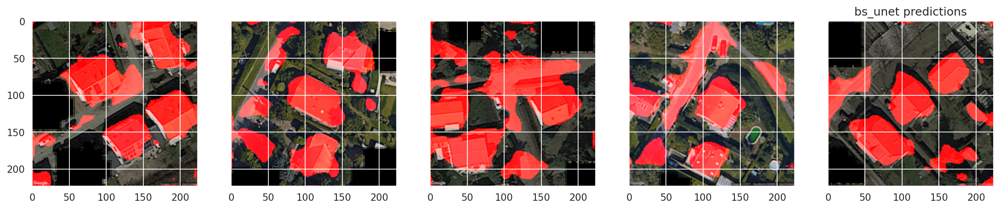

 bst_unet predictions for threshold value: 0.05


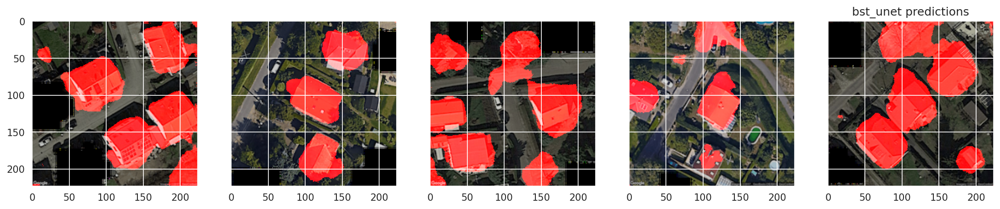

 bs_vgg_unet predictions for threshold value: 0.05


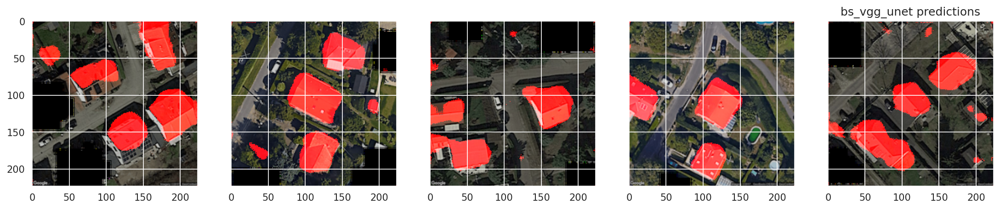

 bst_vgg_unet predictions for threshold value: 0.05


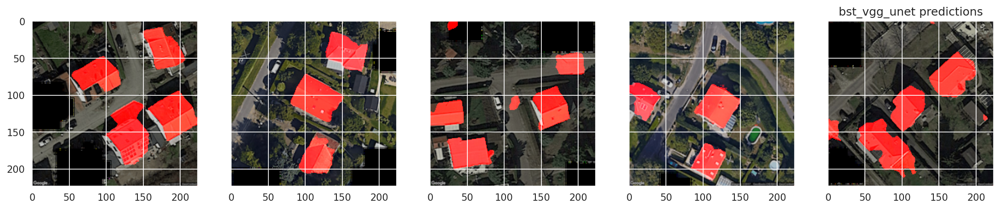

 bs_mob_unet predictions for threshold value: 0.05


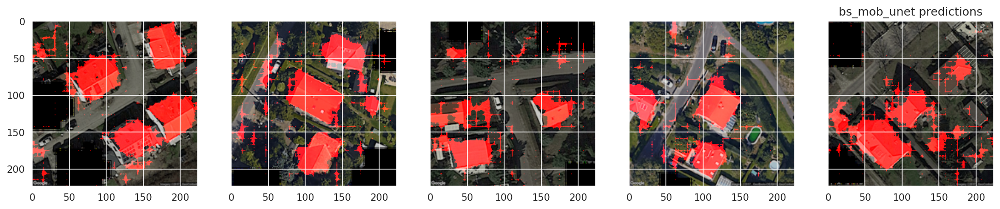

 bst_mob_unet predictions for threshold value: 0.05


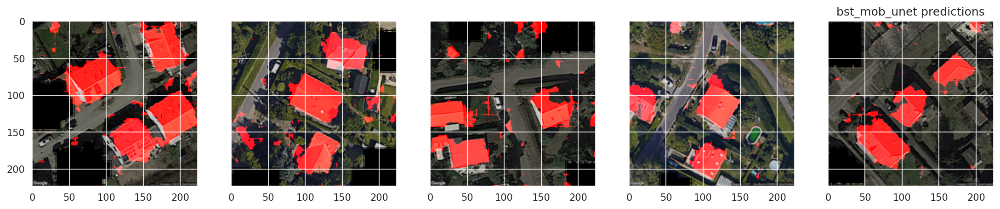

In [80]:
bst_joint_preds(bst_models,processed_test_images)

## References and Conclusions Section
- [Link To Best Models Section](#Best-Models-Section)

- Includes references I went through during this segmentation tasks, and conclusions I made from this whole task

- Conclusions
    - After the training with all the given images, a slight improvement can be spotted in terms of finding a roof, like the roof parts which were not covered fully previously are now covered more efficiently.
    - Also we can see the models overfitted a bit to this training data, cause we can see red spots to the points where ther are no roofs, like pathches on the streets and green fields a bit.
    - However I believe given small amount of data, this is the best I was able to make of problem statement and NN's, hope to hear from you soon Dida team with a feedback or so.
    
- Next Steps
    - If still I have to work with limited data, maybe working on other different architectures is one way to experiment.
    - Rest working on other data segmentation technique for ex.:
        - Here I used semantic segmentation the model predicts: “This pixel is a pixel belonging rooftop”
        - Other way is to use instance segmentation where the model predicts: “This is a rooftop and here are all the pixels of the roof”.
    - Last best step can be trying to alter the architectures of well known architectures might be one way to go.

- [Understanding Semantic Segmentation with UNET](https://towardsdatascience.com/understanding-semantic-segmentation-with-unet-6be4f42d4b47)
- [Transfer Learning and Unet to segment rocks on moon](https://www.kaggle.com/code/basu369victor/transferlearning-and-unet-to-segment-rocks-on-moon)
- [U-Net Implementation from Scratch using TensorFlow](https://github.com/VidushiBhatia/U-Net-Implementation/tree/main)
- [Metrics for Classification](https://developers.google.com/machine-learning/crash-course/classification/)
- Chat GPT if I felt stuck on understanding some concepts

## Thank You, Dida Team